### Листинг 1.1. Построение гистограмм изображения.

In [1]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
from matplotlib.pyplot import figure
from numba import njit, jit
from math import *
import bisect
import warnings
warnings.filterwarnings('ignore')
export_parallel = True
use_graph = True

In [2]:
# Для начала нужно считать изображение.
image = cv2.imread("data/istanbul.jpg")

In [3]:
# Как видно по выводу python, это те самые значения от 0 до 255, 
# Разрешение 2160 на 3840 пикселей и 3 канала BGR
print(np.min(image), np.max(image))
print(image.shape)

0 255
(4000, 6000, 3)


In [4]:
# По определению, гистограмма - распределение частоты встречаемости пикселей одинаковой яркости на изображении.
@njit(parallel=export_parallel)
def calc_hist(image, maximum_intensity=256):
    hist = []
    for i in range(image.shape[2]):
        hist.append([0 for j in range(maximum_intensity)])
    hist = np.array(hist)
    for i in range(image.shape[2]):
        for y in range(image.shape[0]):
            for x in range(image.shape[1]):
                hist[i][image[y][x][i]] += 1
    return hist

my_hist = calc_hist(image)

Выведу рассчитанную гистограмму. Считается она медленнее, чем встроенная функция в numpy, 
но благодаря оптимизации numba время терпимо.
Как видно из полученой вручную гистограммы, ручной рассчёт совпал с встроенным в numpy

0 0
0 0
0 0


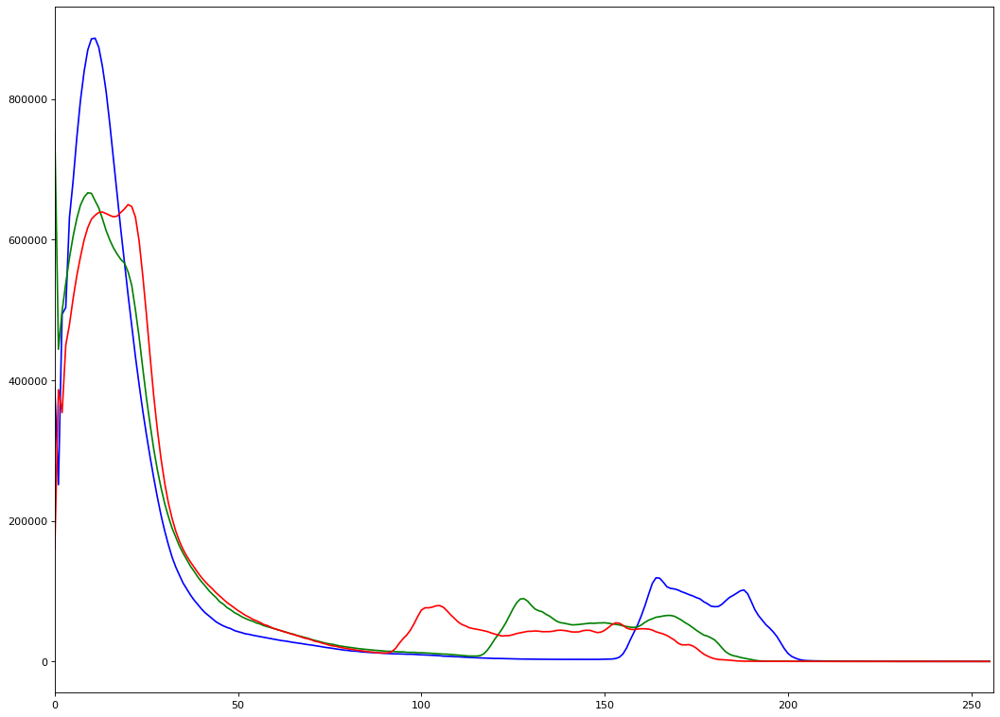

In [5]:
if use_graph:
    color = ('b','g','r')
    figure(figsize=(16, 12), dpi=80)
    for i, col in enumerate(color):
        hist_cv2 = cv2.calcHist([image],[i],None,[256],[0,256])
        hist_cv2 = np.array([hist_cv2[i][0] for i in range(256)], dtype=np.int)
        diff = my_hist[i] - hist_cv2
        print(np.min(diff), np.max(diff))
        plt.plot(my_hist[i], color = col)
    plt.xlim([0,256])

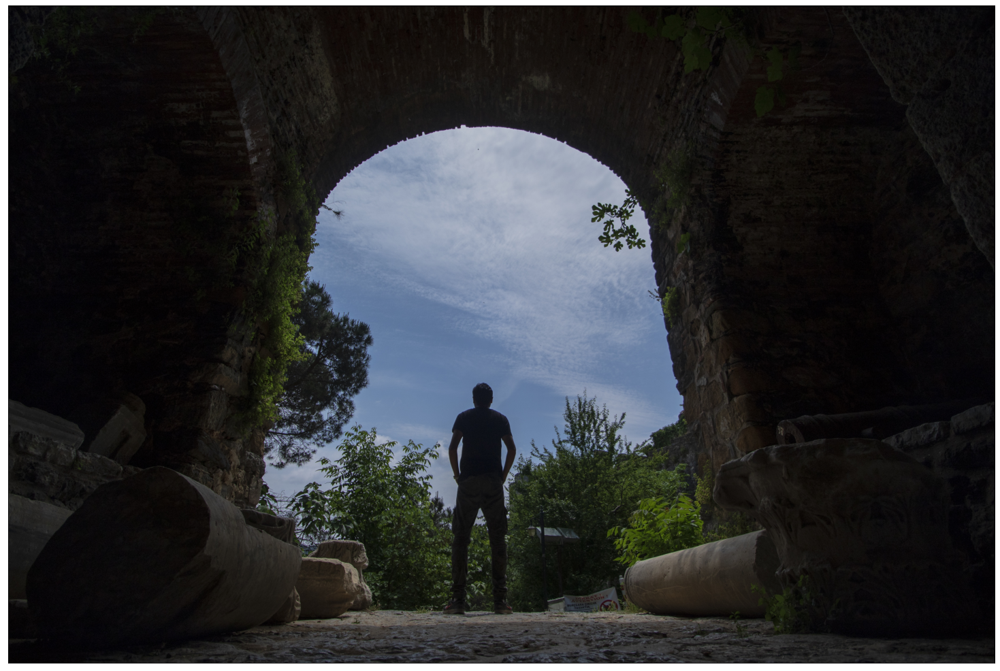

In [6]:
# Исходное изображение
if use_graph:
    figure(figsize=(32, 16), dpi=80)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.xticks([]),plt.yticks([])
    plt.show()

Как видно из Гистограммы, присутствует много тёмных пиков, и сложно сказать, 
что вообще изображено на краях фотографии, также присутствуют пики одинаковой интенсивности 
яркости около 150. Есть, где поиграться с гистограммой.

### Листинг 1.2. Арифметические операции.

Простейшими способами выравнивания гистограммы являются арифметические операции с изображениями. 
Например, в случае если большинство значений гистограммы находятся слева, то изображение является темным. 
Для увеличения детализации темных областей можно сдвинуть гистограмму правее, в более светлую область.

In [7]:
linear_bias = 50 # Величина линейного сдвига интенсивностей
image_linear_bias = np.clip(image + linear_bias, 0, 255) # Ограничу полученую интенсивность снизу 0 и сверху 255
hist_linear_bias = calc_hist(image_linear_bias) # Вычислю гистограмму

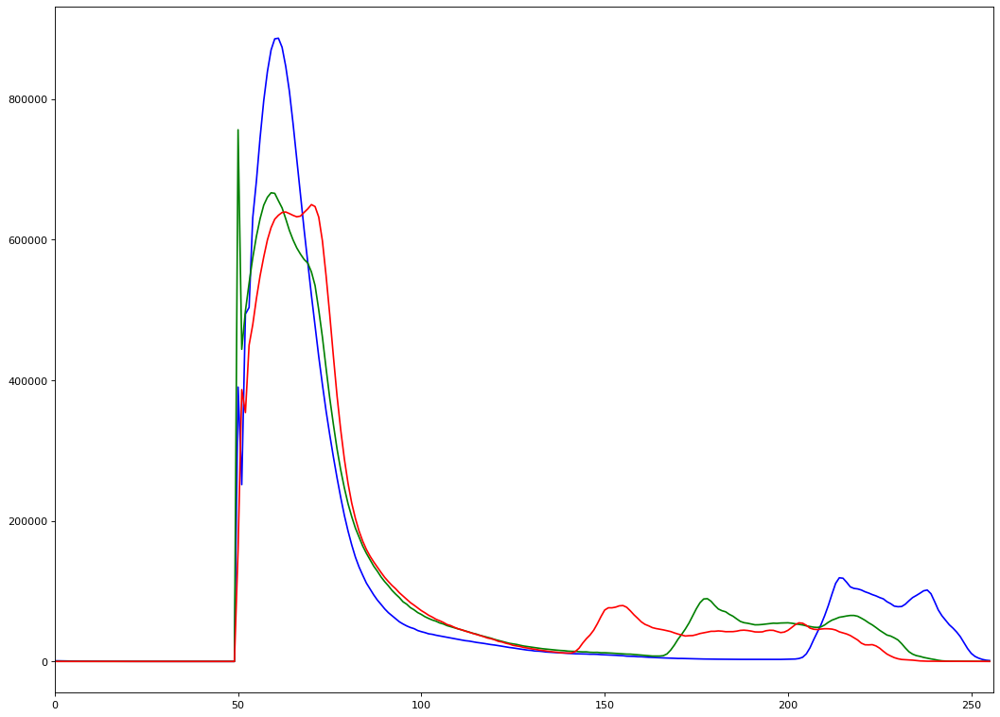

In [8]:
# Отображу полученную после линейного сдвига гистограмму
if use_graph:
    color = ('b','g','r')
    figure(figsize=(16, 12), dpi=80)
    for i, col in enumerate(color):
        plt.plot(hist_linear_bias[i], color = col)
    plt.xlim([0,256])

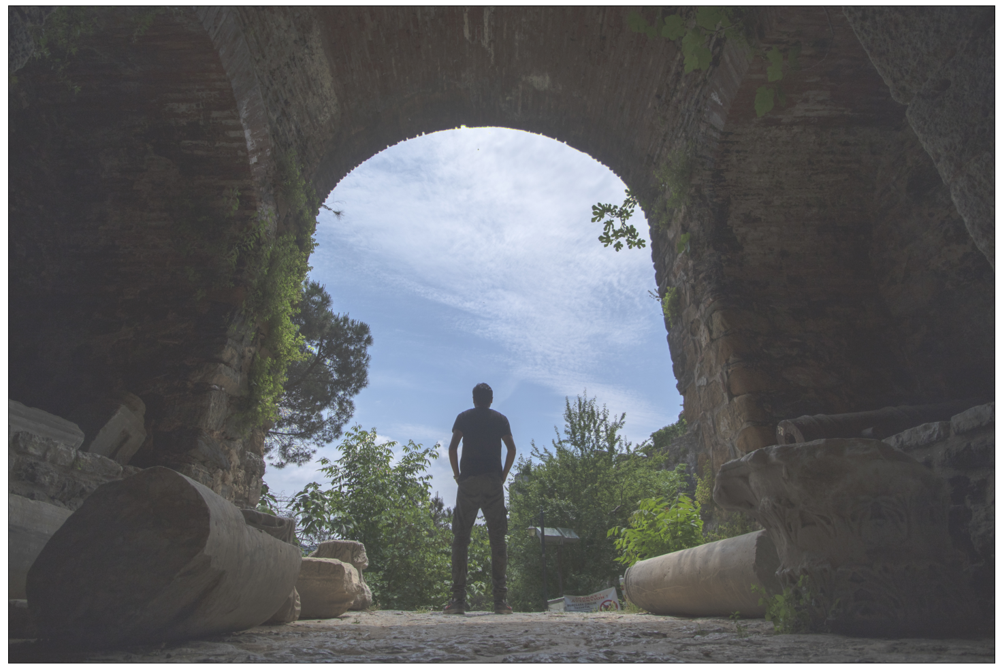

In [9]:
# Изображение после линейного сдвига интенсивностей
if use_graph:
    figure(figsize=(32, 16), dpi=80)
    plt.imshow(cv2.cvtColor(image_linear_bias, cv2.COLOR_BGR2RGB))
    plt.xticks([]),plt.yticks([])
    plt.show()

Как видно, на этот раз стали различимы стены и узор на мраморных плитах.

### Листинг 1.3. Растяжение динамического диапазона

Если интенсивности пикселей областей интереса находятся в узком динамическом диапазоне, 
то можно растянуть этот диапазон. Подобные преобразования выполняются согласно следующему выражению:

𝐼𝑛𝑒𝑤 = 256 * ((𝐼 − 𝐼𝑚𝑖𝑛)/(𝐼𝑚𝑎𝑥 − 𝐼𝑚𝑖𝑛 ))^𝛼 (1.1)

где 𝐼 и 𝐼𝑛𝑒𝑤 — массивы значений интенсивностей исходного и нового изображений соответственно; 
𝐼𝑚𝑖𝑛 и 𝐼𝑚𝑎𝑥 — минимальное и максимальное значения интенсивностей исходного изображения соответственно; 
𝛼 — коэффициент нелинейности.

Данное выражение является нелинейным из-за коэффициента
𝛼. В случае, если 𝛼 = 1, применение формулы (1.1) к исходному
изображению не даст желаемого эффекта, поскольку гистограммы
цветовых компонент изображения занимают весь возможный диапазон. Нелинейные преобразования проводятся для каждой цветовой составляющей.

In [10]:
@njit(parallel=export_parallel)
def calc_nonlinear_stretching(image, alpha, Imin, Imax):
    for i in range(image.shape[2]):
        for y in range(image.shape[0]):
            for x in range(image.shape[1]):
                image[y,x,i] = 255.0 * np.power((image[y,x,i] - Imin[i]) / (Imax[i] - Imin[i]), alpha)
    return image

In [11]:
alpha = 0.5 # Как просили, возьму это значение

# Вычисление максимальных и минимальных интенсивностей по каждому из каналов
Imin = [np.min(image[:,:,i]) for i in range(image.shape[2])]
Imax = [np.max(image[:,:,i]) for i in range(image.shape[2])]
print(Imin)
print(Imax)

# Вычисление нелинейного преобразования интенсивностей и гистограммы
image_nonlinear_stretching = calc_nonlinear_stretching(np.array(image, dtype=np.float64), alpha, Imin, Imax)

image_nonlinear_stretching = np.round(image_nonlinear_stretching).astype(dtype=np.uint8)
hist_nonlinear_stretching = calc_hist(image_nonlinear_stretching)

[0, 0, 0]
[255, 238, 233]


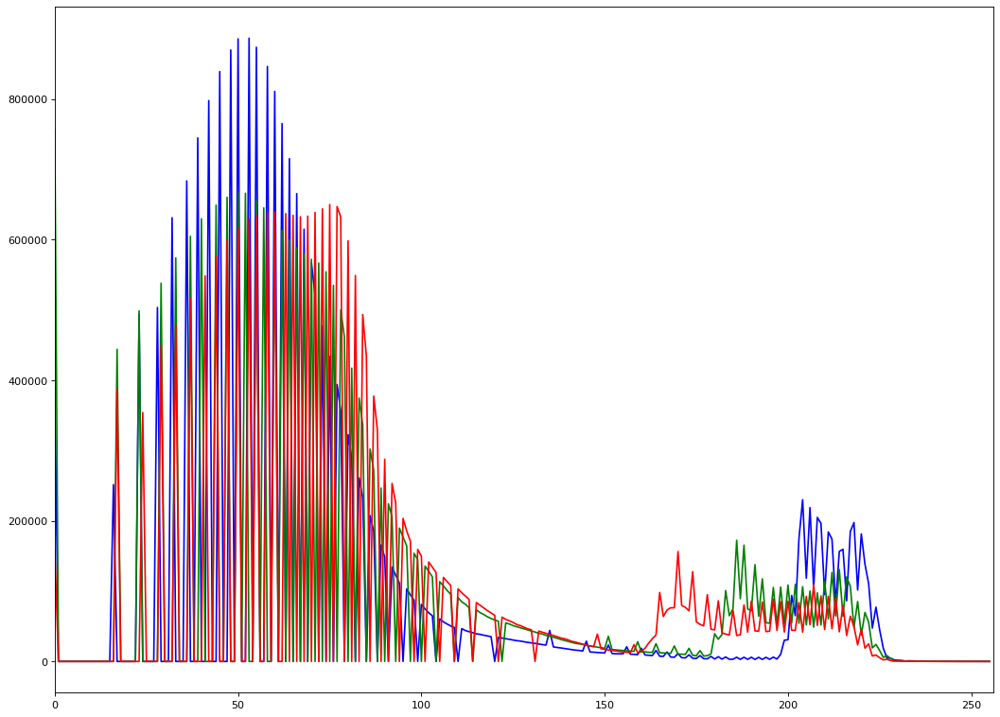

In [12]:
# Отображу полученную после нелинейного преобразования интенсивностей гистограмму
if use_graph:
    color = ('b','g','r')
    figure(figsize=(16, 12), dpi=80)
    for i, col in enumerate(color):
        plt.plot(hist_nonlinear_stretching[i], color = col)
    plt.xlim([0,256])

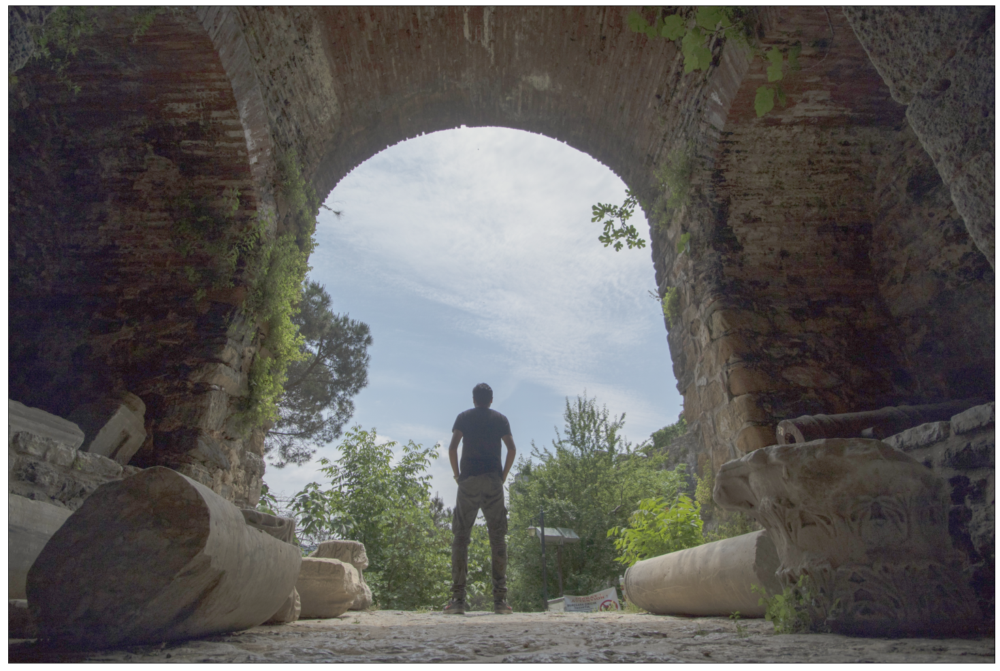

In [13]:
# Изображение после нелинейного преобразования интенсивностей
if use_graph:
    figure(figsize=(32, 16), dpi=80)
    plt.imshow(cv2.cvtColor(image_nonlinear_stretching, cv2.COLOR_BGR2RGB))
    plt.xticks([]),plt.yticks([])
    plt.show()

Можно с уверенностью сказать, что изображение стало более различимым. Некогда тёмные области теперь будто бы освещены.
Полученная гистограмма имеет неровности, которые могут быть связаны с обратным преобразованием всего в int, 
а значит наложение соседних интенсивностей.

### Листинг 1.4. Равномерное преобразование

Осуществляется по следующей формуле:

𝐼𝑛𝑒𝑤 = (𝐼𝑚𝑎𝑥 − 𝐼𝑚𝑖𝑛) · 𝑃(𝐼) + 𝐼𝑚𝑖𝑛, (1.2)

где 𝐼𝑚𝑖𝑛, 𝐼𝑚𝑎𝑥 — минимальное и максимальное значения интенсивностей исходного изображения 𝐼; 
𝑃(𝐼) — функция распределения вероятностей исходного изображения, 
которая аппроксимируется кумулятивной гистограммой:

𝑃(𝐼) ≈ sum(Hist(𝑚) for 𝑚 in range(0, I)) / (numRows * numCols) (1.3)

In [14]:
# Вычисление кумулятивной гистограммы изображения без нормирования
@njit(parallel=export_parallel)
def calc_cumulative_hist(image, maximum_intensity=256):
    hist = []
    for i in range(image.shape[2]):
        hist.append([0 for j in range(maximum_intensity)])
    hist = np.array(hist)
    for i in range(image.shape[2]):
        for y in range(image.shape[0]):
            for x in range(image.shape[1]):
                hist[i][image[y][x][i]] += 1
        for j in range(maximum_intensity - 1):
            hist[i][j + 1] += hist[i][j]
    return hist

# Применение равномерного преобразования
@njit(parallel=export_parallel)
def apply_cumulative_hist(image, cumulative_hist):
    Imin = [np.min(image[:,:,i]) for i in range(image.shape[2])]
    Imax = [np.max(image[:,:,i]) for i in range(image.shape[2])]
    image_new = np.zeros(image.shape, dtype="uint8")
    for i in range(image.shape[2]):
        for y in range(image.shape[0]):
            for x in range(image.shape[1]):
                Inew = (Imax[i] - Imin[i]) * cumulative_hist[i][image[y][x][i]] + Imin[i]
                if Inew < 0:
                    Inew = 0
                if Inew > 255:
                    Inew = 255
                image_new[y][x][i] = int(round(Inew))
    return image_new

In [15]:
image_cumulative_hist = calc_cumulative_hist(image)
image_cumulative_hist = image_cumulative_hist.astype(dtype=np.float64) / (image.shape[0] * image.shape[1])
image_uniform_transformation = apply_cumulative_hist(image, image_cumulative_hist)
hist_uniform_transformation = calc_hist(image_uniform_transformation)

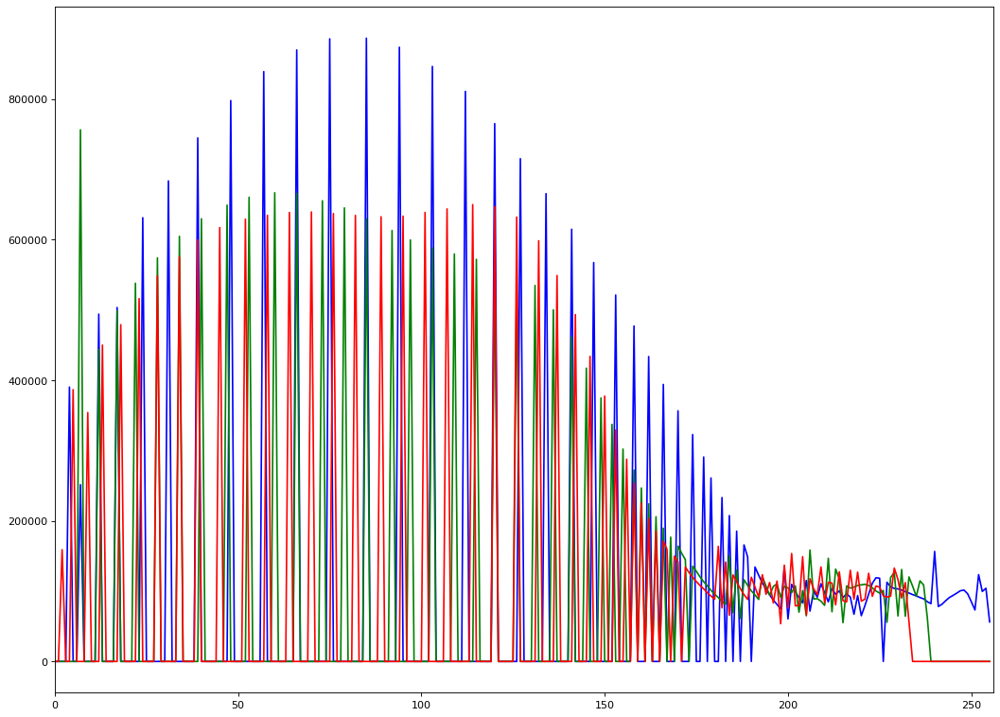

In [16]:
# Отображу полученную после равномерного преобразования интенсивностей гистограмму
if use_graph:
    color = ('b','g','r')
    figure(figsize=(16, 12), dpi=80)
    for i, col in enumerate(color):
        plt.plot(hist_uniform_transformation[i], color = col)
    plt.xlim([0,256])

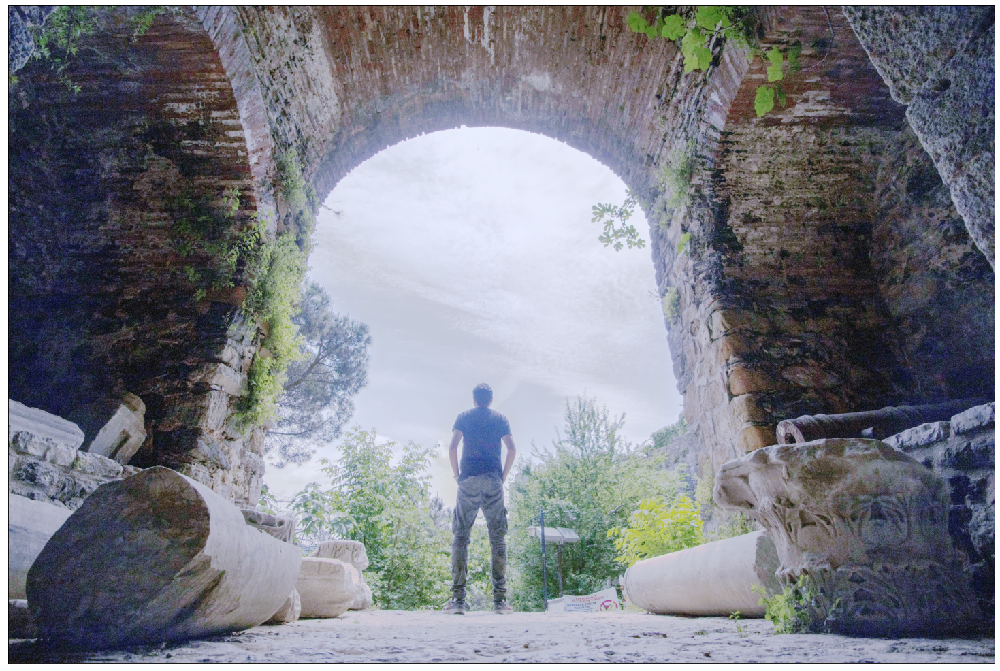

In [17]:
# Изображение после равномерного преобразования интенсивностей
if use_graph:
    figure(figsize=(32, 16), dpi=80)
    plt.imshow(cv2.cvtColor(image_uniform_transformation, cv2.COLOR_BGR2RGB))
    plt.xticks([]),plt.yticks([])
    plt.show()

Достигнут эффект какого-то из фильтров в программе для редактирования фотографий. 
Выглядит круто! Силуэт человека превратился в его хорошо освещённое изображение, даже со спины. 
Тёные уголки строений теперь будто бы отвещены дневным светом.
Узоры не просто различимы, но и отчётливо видны.
Гистограмма, только, снова болеет. Не ровная получилась, много цветов пропадает.

### Листинг 1.5. Экспоненциальное преобразование

Осуществляется по следующей формуле:
𝐼𝑛𝑒𝑤 = 𝐼𝑚𝑖𝑛 + 255 · (1 / 𝛼) · ln(1 − 𝑃(𝐼)), (1.4)

где 𝛼 — постоянная, характеризующая крутизну преобразования.

Согласно формуле (1.4) можно вычислить значения интенсивностей пикселей результирующего изображения.

In [18]:
# Применение экспоненциального преобразования
@njit(parallel=export_parallel)
def apply_exponential_hist(image, cumulative_hist, alpha):
    Imin = [np.min(image[:,:,i]) for i in range(image.shape[2])]
    image_new = np.zeros(image.shape, dtype="uint8")
    for i in range(image.shape[2]):
        for y in range(image.shape[0]):
            for x in range(image.shape[1]):
                Inew = Imin[i] - 255.0 * (1 / alpha) * log(1 - cumulative_hist[i][image[y][x][i]])
                if Inew < 0:
                    Inew = 0
                if Inew > 255:
                    Inew = 255
                image_new[y][x][i] = int(round(Inew))
    return image_new

In [19]:
image_cumulative_hist = calc_cumulative_hist(image)
image_cumulative_hist = image_cumulative_hist.astype(dtype=np.float64) / (image.shape[0] * image.shape[1])
image_exponential_transformation = apply_exponential_hist(image, image_cumulative_hist, alpha=1.7)
hist_exponential_transformation = calc_hist(image_exponential_transformation)

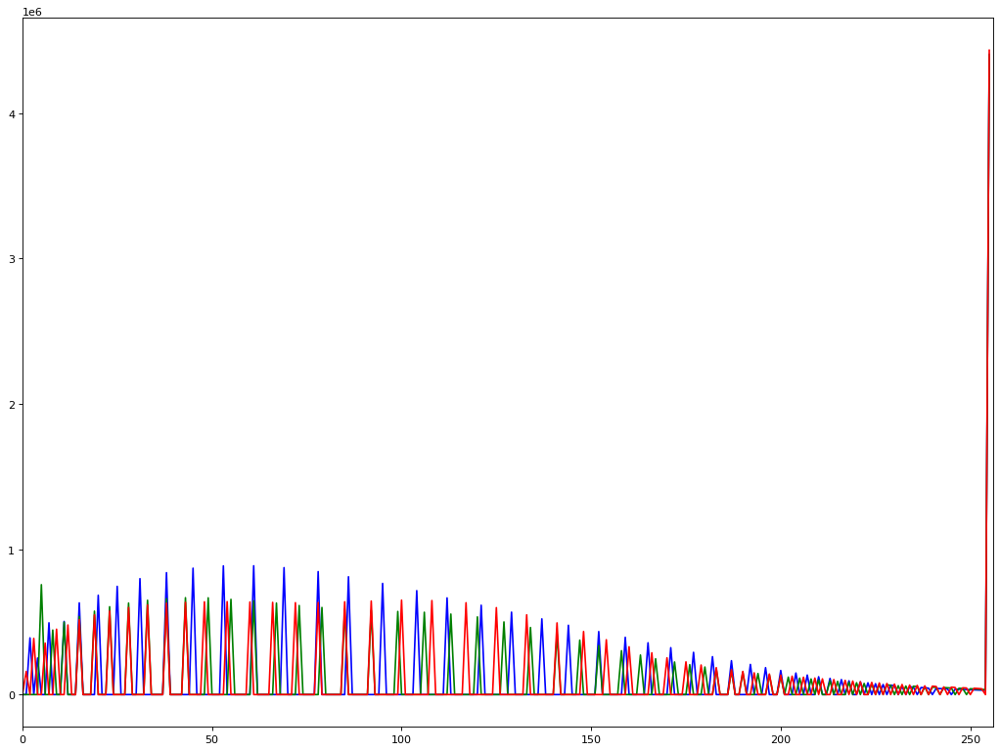

In [20]:
# Отображу полученную после экспоненциального преобразования интенсивностей гистограмму
if use_graph:
    color = ('b','g','r')
    figure(figsize=(16, 12), dpi=80)
    for i, col in enumerate(color):
        plt.plot(hist_exponential_transformation[i], color = col)
    plt.xlim([0,256])

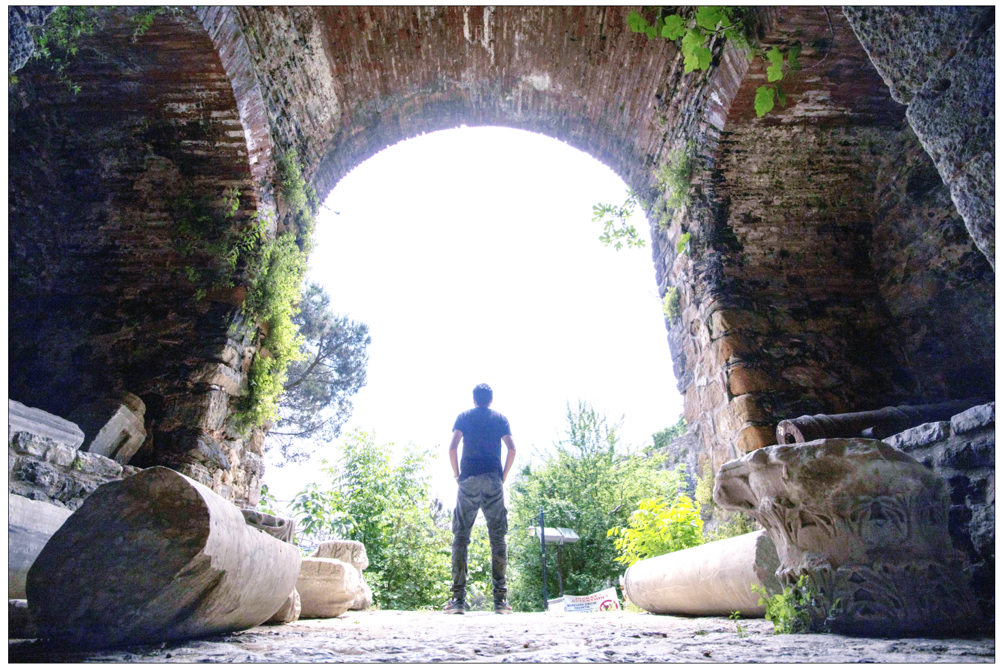

In [21]:
# Изображение после экспоненциального преобразования интенсивностей
if use_graph:
    figure(figsize=(32, 16), dpi=80)
    plt.imshow(cv2.cvtColor(image_exponential_transformation, cv2.COLOR_BGR2RGB))
    plt.xticks([]),plt.yticks([])
    plt.show()

При параметре 𝛼 = 1.7 изображение получилось просто приятнее глазу, чем при нелинейном преобразовании. 
Будто бы цветовая гамма подбиралась под человеческое восприятие.
Сама гистограмма пусть снова потеряла несколько цветов, но стала более равномерной и похожей на нормальное распределение.
При этом на ней присутствует пик белого цвета. 

### Листинг 1.6. Преобразование по закону Рэлея

Осуществляется по следующей формуле:

𝐼𝑛𝑒𝑤 = 𝐼𝑚𝑖𝑛 + 255 · (2*𝛼^2 * log(1 / (1 − 𝑃(𝐼)))) ^ (1/2),

где 𝛼 — постоянная, характеризующая гистограмму распределения интенсивностей элементов результирующего изображения.

In [22]:
# Применение преобразования Рэлея
@njit(parallel=export_parallel)
def apply_Rayleigh_hist(image, cumulative_hist, alpha):
    Imin = [np.min(image[:,:,i]) for i in range(image.shape[2])]
    image_new = np.zeros(image.shape, dtype="uint8")
    for i in range(image.shape[2]):
        for y in range(image.shape[0]):
            for x in range(image.shape[1]):
                Inew = Imin[i] + 255.0 * pow((2 * pow(alpha, 2) * log(1 / (1 + 1e-9 - cumulative_hist[i][image[y][x][i]]))), 0.5)
                if Inew < 0:
                    Inew = 0
                if Inew > 255:
                    Inew = 255
                image_new[y][x][i] = int(round(Inew))
    return image_new

In [23]:
image_cumulative_hist = calc_cumulative_hist(image)
image_cumulative_hist = image_cumulative_hist.astype(dtype=np.float64) / (image.shape[0] * image.shape[1])
image_Rayleigh_transformation = apply_Rayleigh_hist(image, image_cumulative_hist, alpha=0.4)
hist_Rayleigh_transformation = calc_hist(image_Rayleigh_transformation)

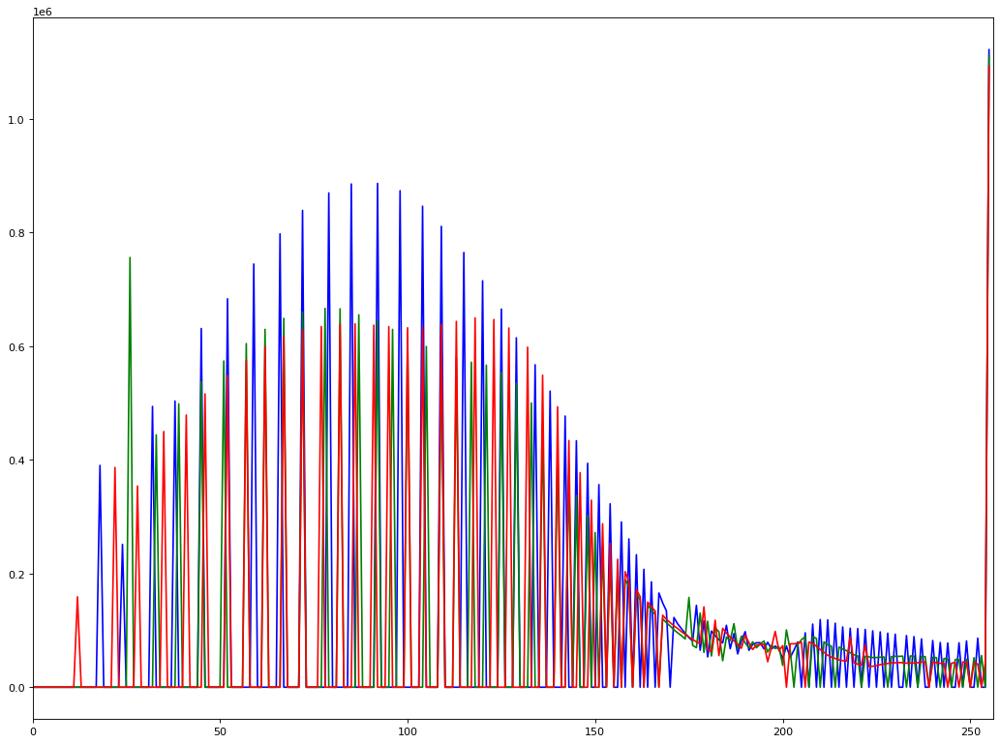

In [24]:
# Отображу полученную после преобразования Рэлея гистограмму
if use_graph:
    color = ('b','g','r')
    figure(figsize=(16, 12), dpi=80)
    for i, col in enumerate(color):
        plt.plot(hist_Rayleigh_transformation[i], color = col)
    plt.xlim([0,256])

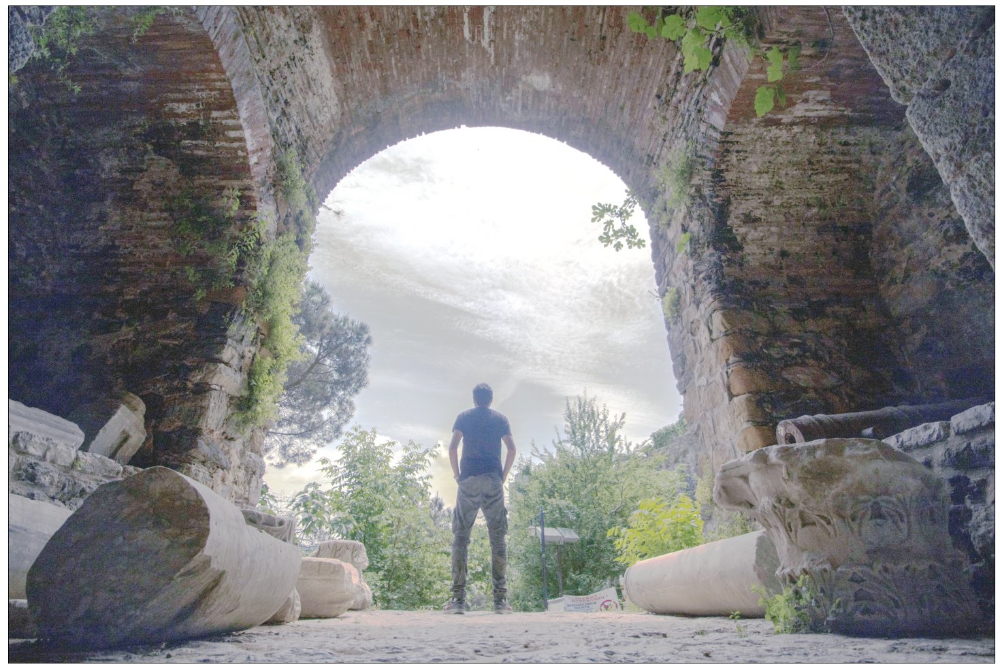

In [25]:
# Изображение после преобразования Рэлея
if use_graph:
    figure(figsize=(32, 16), dpi=80)
    plt.imshow(cv2.cvtColor(image_Rayleigh_transformation, cv2.COLOR_BGR2RGB))
    plt.xticks([]),plt.yticks([])
    plt.show()

При 𝛼 = 0.4 изображение получается ярким и насыщенным, даже видны облака,
а гистограмма интенсивности всё больше походит на нормальное распределение.
Тем не менее, всё ещё присутствует пик белого цвета на гистограмме.

### Листинг 1.7. Преобразование по закону степени 2/3

Осуществляется по следующей формуле:
𝐼𝑛𝑒𝑤 = 255 · (𝑃(𝐼)) ^ (2/3)

In [26]:
# Применение преобразования по закону степени 2/3
@njit(parallel=export_parallel)
def apply_pow_2_3_hist(image, cumulative_hist):
    image_new = np.zeros(image.shape, dtype="uint8")
    for i in range(image.shape[2]):
        for y in range(image.shape[0]):
            for x in range(image.shape[1]):
                Inew = 255.0 * pow(cumulative_hist[i][image[y][x][i]], 2 / 3)
                if Inew < 0:
                    Inew = 0
                if Inew > 255:
                    Inew = 255
                image_new[y][x][i] = int(round(Inew))
    return image_new

In [27]:
image_cumulative_hist = calc_cumulative_hist(image)
image_cumulative_hist = image_cumulative_hist.astype(dtype=np.float64) / (image.shape[0] * image.shape[1])
image_pow_2_3_transformation = apply_pow_2_3_hist(image, image_cumulative_hist)
hist_pow_2_3_transformation = calc_hist(image_pow_2_3_transformation)

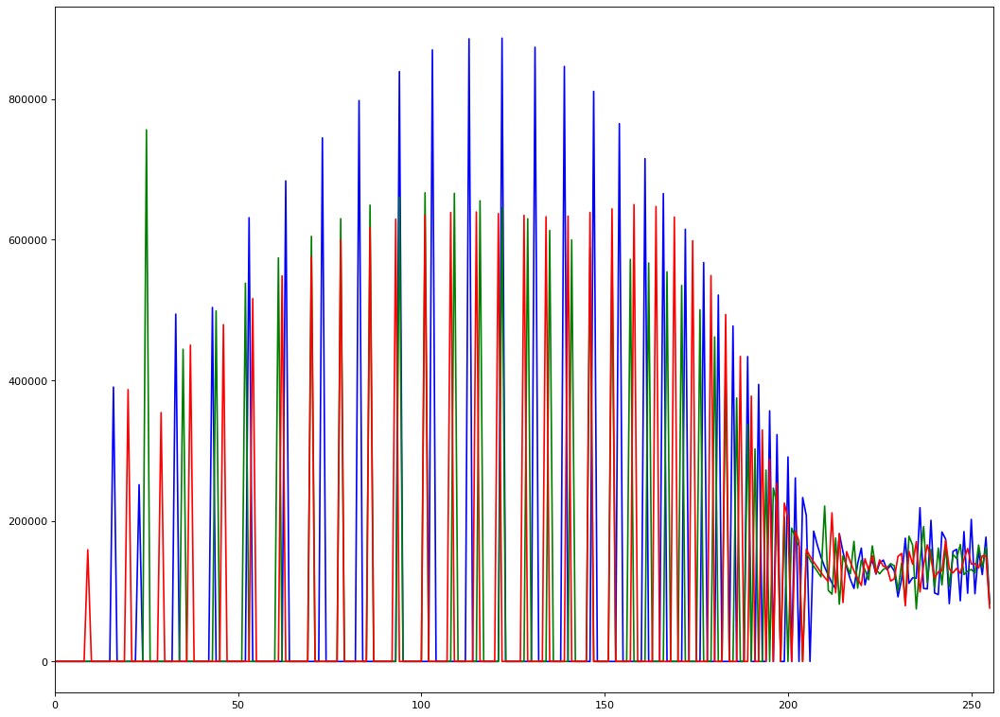

In [28]:
# Отображу полученную после преобразования по закону степени 2/3 гистограмму
if use_graph:
    color = ('b','g','r')
    figure(figsize=(16, 12), dpi=80)
    for i, col in enumerate(color):
        plt.plot(hist_pow_2_3_transformation[i], color = col)
    plt.xlim([0,256])

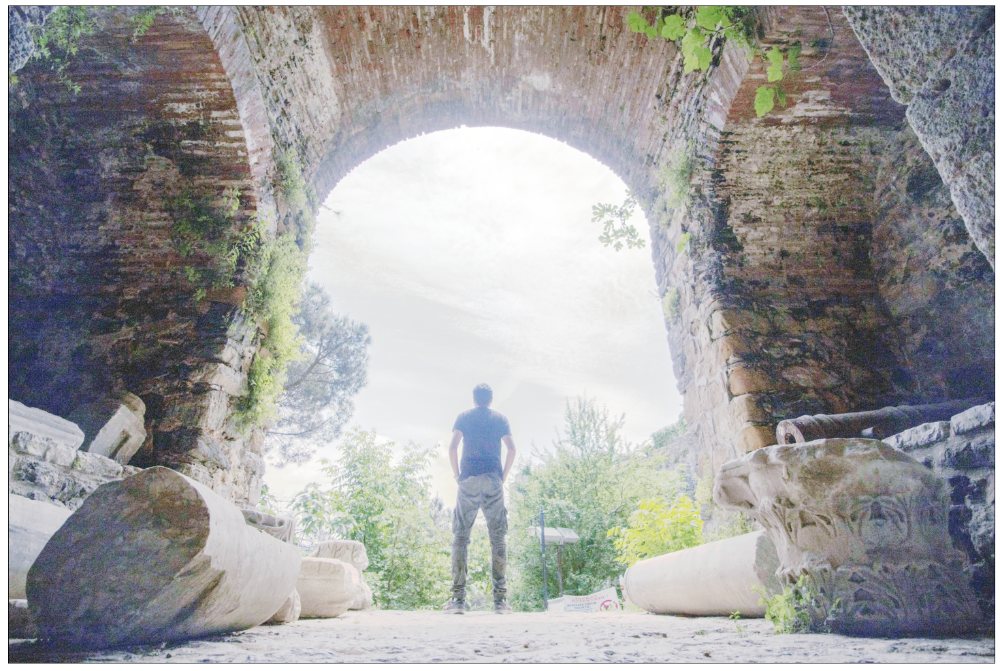

In [29]:
# Изображение после преобразования по закону степени 2/3
if use_graph:
    figure(figsize=(32, 16), dpi=80)
    plt.imshow(cv2.cvtColor(image_pow_2_3_transformation, cv2.COLOR_BGR2RGB))
    plt.xticks([]),plt.yticks([])
    plt.show()

Не то что бы результат впечатляющий, но простота решения не может не удивлять.
Изображение лучше исходного, но хуже преобразований экспоненциального или Рэлея, 
так как некоторые области сильно засвечены. 
Зато Гистограмма также похожа на нормальное распределение.

### Листинг 1.8. Гиперболическое преобразование

Осуществляется по следующей формуле:
𝐼𝑛𝑒𝑤 = 255 * 𝛼 ^ (𝑃 (𝐼)),

где 𝛼 — постоянная, относительно которой осуществляется преобразование и, как правило, 
равная минимальному значению интенсивности элементов исходного изображения 𝛼 = 𝐼𝑚𝑖𝑛.

In [30]:
# Применение гиперболического преобразования
@njit(parallel=export_parallel)
def apply_hyperbolic_hist(image, cumulative_hist, alpha_bias=0):
    alpha = [np.min(image[:,:,i]) for i in range(image.shape[2])]
    image_new = np.zeros(image.shape, dtype="uint8")
    for i in range(image.shape[2]):
        for y in range(image.shape[0]):
            for x in range(image.shape[1]):
                Inew = 255.0 * pow(alpha[i] + alpha_bias, cumulative_hist[i][image[y][x][i]])
                if Inew < 0:
                    Inew = 0
                if Inew > 255:
                    Inew = 255
                image_new[y][x][i] = int(round(Inew))
    return image_new

In [31]:
image_cumulative_hist = calc_cumulative_hist(image)
image_cumulative_hist = image_cumulative_hist.astype(dtype=np.float64) / (image.shape[0] * image.shape[1])
image_hyperbolic_transformation = apply_hyperbolic_hist(image, image_cumulative_hist, alpha_bias=0.01)
hist_hyperbolic_transformation = calc_hist(image_hyperbolic_transformation)

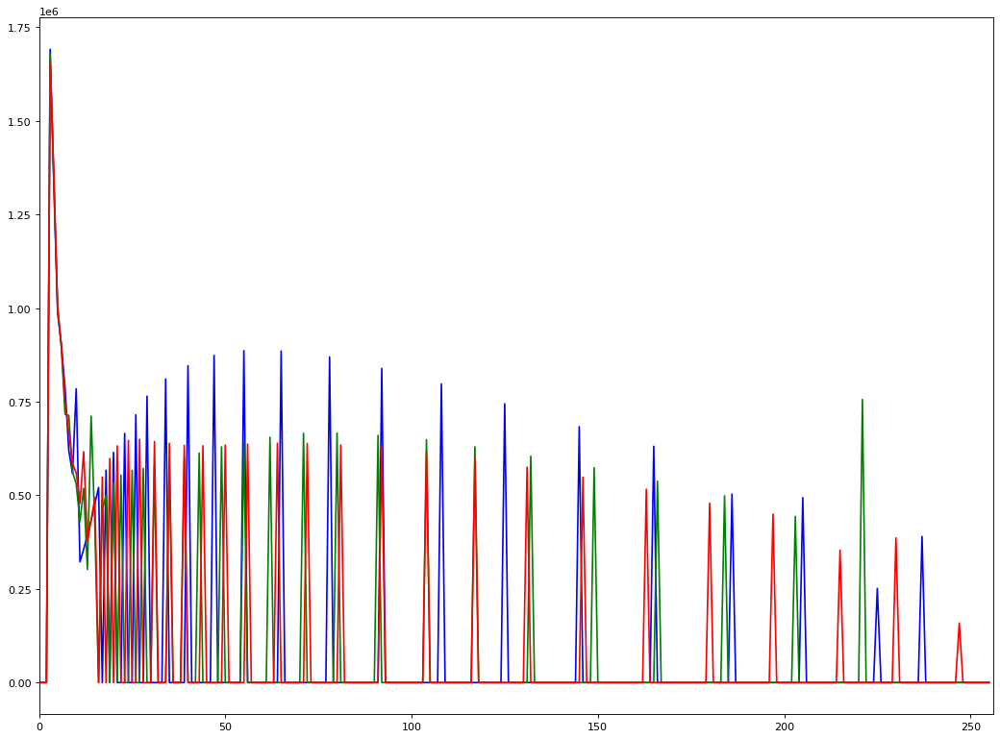

In [32]:
# Отображу полученную после гиперболического преобразования гистограмму
if use_graph:
    color = ('b','g','r')
    figure(figsize=(16, 12), dpi=80)
    for i, col in enumerate(color):
        plt.plot(hist_hyperbolic_transformation[i], color = col)
    plt.xlim([0,256])

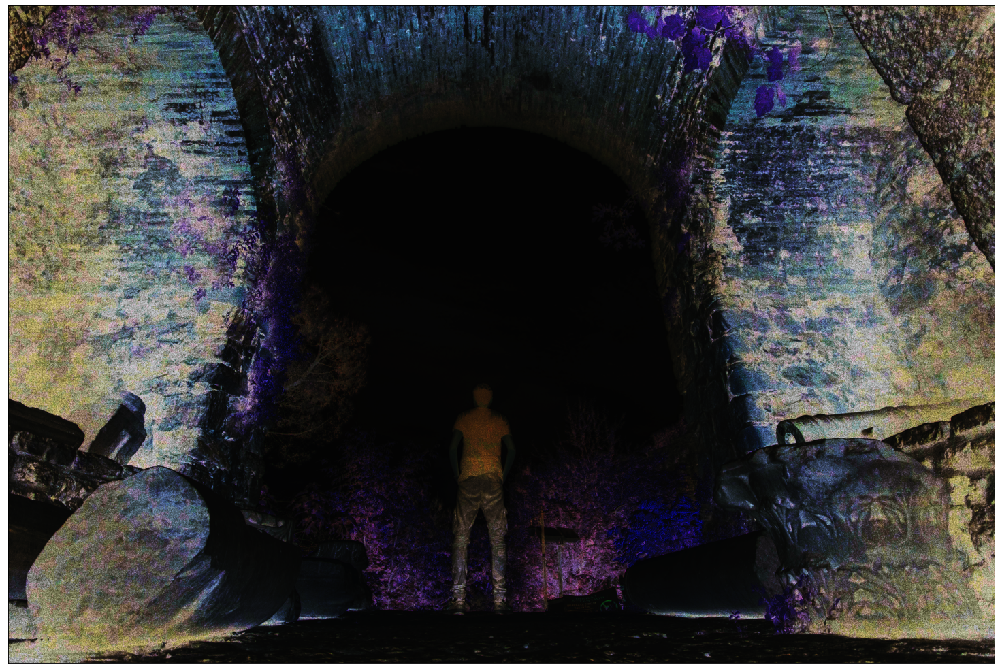

In [33]:
# Изображение после гиперболического преобразования
if use_graph:
    figure(figsize=(32, 16), dpi=80)
    plt.imshow(cv2.cvtColor(image_hyperbolic_transformation, cv2.COLOR_BGR2RGB))
    plt.xticks([]),plt.yticks([])
    plt.show()

Чтобы не возводить 0 во всякие там степени было решено ввести дополнительное смещение нуля alpha_bias, 
чтобы увидеть хотя бы что-то на изображении.
Сказать, что это изображение выглядит странно - это ничего не сказать. 
Преобразование может быть полезно для задач технического зрения, так как тут очётливо виден рельеф тёмных поверхностей.
Также это немного похоже на эффект "Негатив".
Гистограмма интенсивности ведёт себя не постоянно и сильно меняется от изменения коэффициента alpha_bias.

Рассмотренные методы преобразования гистограмм могут применяться для устранения искажений при передаче уровней 
квантования, которым были подвергнуты изображения на этапе формирования, передачи или обработки данных. 
Кроме того, данные методы могут применяться не только ко всему изображению, но использоваться локально в скользящем окне, 
что позволит повыситьдетализированность отдельных областей.

В среде MATLAB реализовано несколько функций, автоматически выравнивающих гистограммы полутонового изображения:
1. imadjust() — повышает контрастность изображения, изменяя диапазон интенсивностей исходного изображения;
2. histeq() — эквализирует (выравнивает) гистограмму методом распределения значений интенсивностей элементов 
исходного изображения;
3. adapthisteq() — выполняет контрастно-ограниченное адаптивное выравнивание гистограммы методом анализа и 
эквализации гистограмм локальных окрестностей изображения.

Их аналоги в opencv соответственно:
1. y = (((x - a) / (b - a)) ** gamma) * (d - c) + c
2. equalizeHist (example https://docs.opencv.org/master/d5/daf/tutorial_py_histogram_equalization.html)
3. createCLAHE (Contrast Limited Adaptive Histogram Equalization); (example https://docs.opencv.org/master/d5/daf/tutorial_py_histogram_equalization.html)

Встаёт вопрос, а зачем нам вообще нужен Matlab?

In [34]:
"""
Made by ashkan from
https://stackoverflow.com/questions/39767612/what-is-the-equivalent-of-matlabs-imadjust-in-python
"""

def imadjust(x,a,b,c,d,gamma=1):
    # Similar to imadjust in MATLAB.
    # Converts an image range from [a,b] to [c,d].
    # The Equation of a line can be used for this transformation:
    #   y=((d-c)/(b-a))*(x-a)+c
    # However, it is better to use a more generalized equation:
    #   y=((x-a)/(b-a))^gamma*(d-c)+c
    # If gamma is equal to 1, then the line equation is used.
    # When gamma is not equal to 1, then the transformation is not linear.

    y = (((x - a) / (b - a)) ** gamma) * (d - c) + c
    return y


def imadjust_rgb(image):
    image = 255 * imadjust(image,image.min(),image.max(),0,1)
    image = image.astype("uint8")
    return image


In [35]:
# imadjust
image_imadjust = imadjust_rgb(image)
hist_imadjust = calc_hist(image_imadjust)

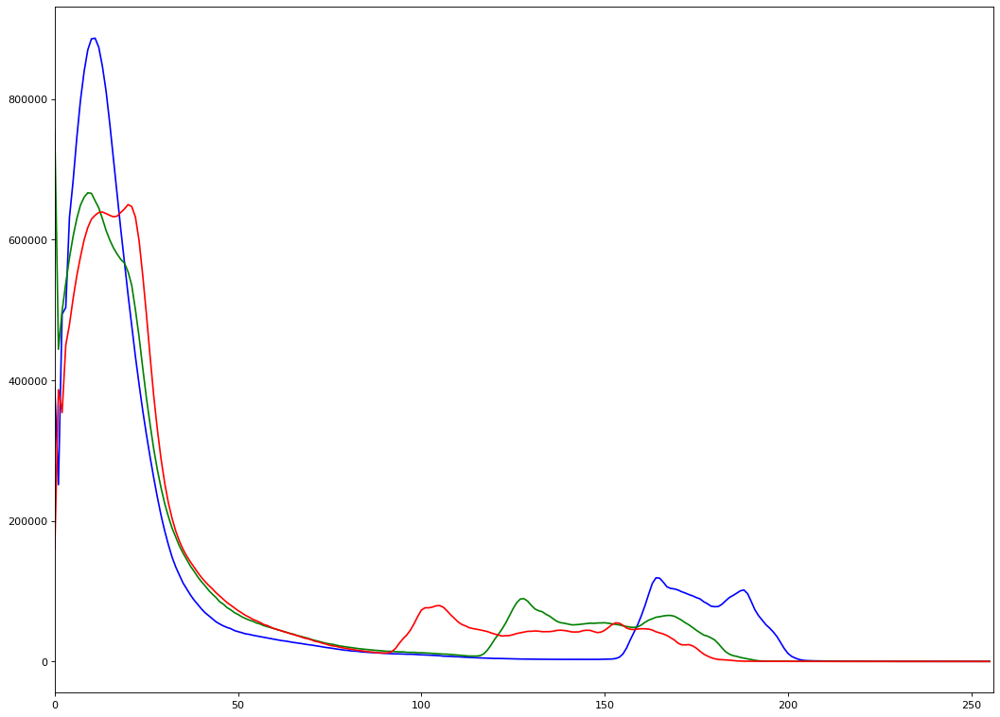

In [36]:
# Отображу полученную после imadjust гистограмму
if use_graph:
    color = ('b','g','r')
    figure(figsize=(16, 12), dpi=80)
    for i, col in enumerate(color):
        plt.plot(hist_imadjust[i], color = col)
    plt.xlim([0,256])

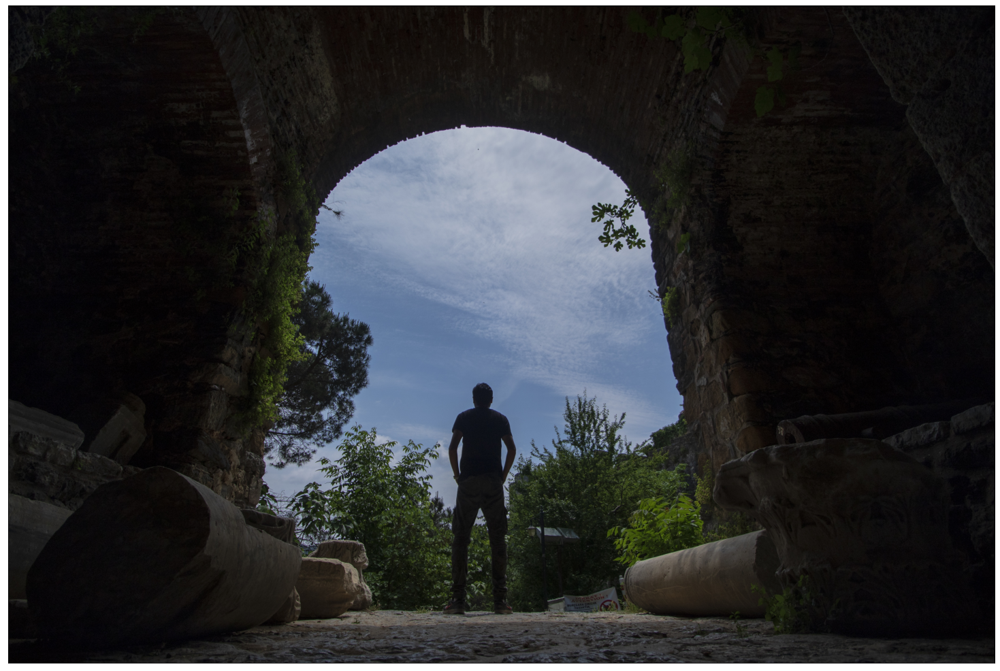

In [37]:
# Изображение после imadjust
if use_graph:
    figure(figsize=(32, 16), dpi=80)
    plt.imshow(cv2.cvtColor(image_imadjust, cv2.COLOR_BGR2RGB))
    plt.xticks([]),plt.yticks([])
    plt.show()

In [38]:
# equalizeHist
channels = cv2.split(image)
for i in range(len(channels)):
    channels[i] = cv2.equalizeHist(channels[i])
image_equalizeHist = cv2.merge(channels)
hist_equalizeHist = calc_hist(image_equalizeHist)

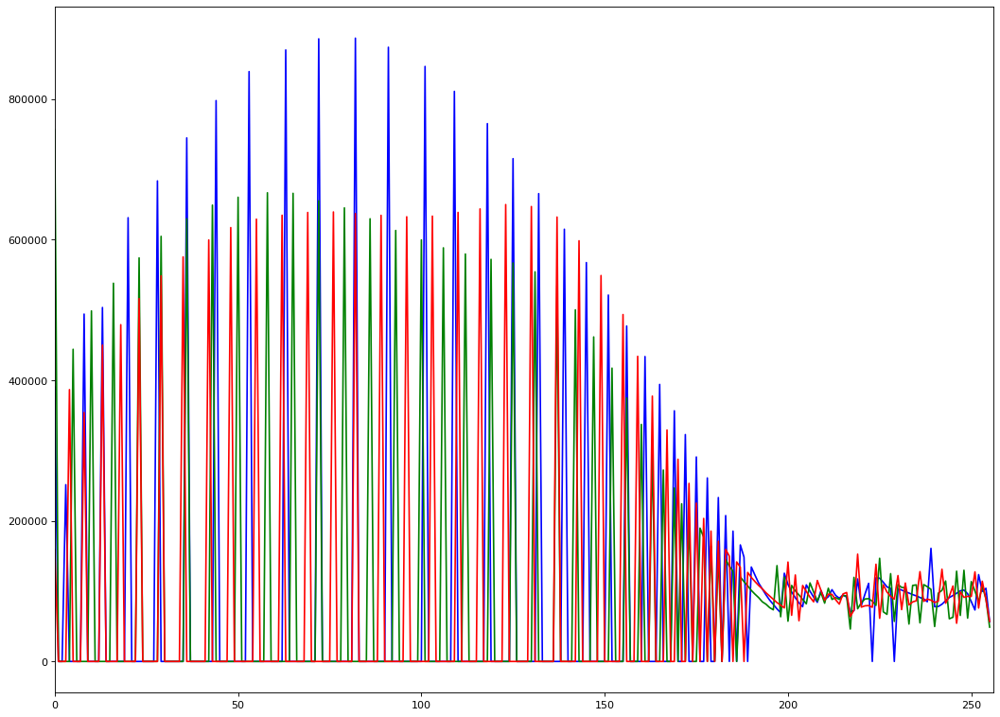

In [39]:
# Отображу полученную после equalizeHist гистограмму
if use_graph:
    color = ('b','g','r')
    figure(figsize=(16, 12), dpi=80)
    for i, col in enumerate(color):
        plt.plot(hist_equalizeHist[i], color = col)
    plt.xlim([0,256])

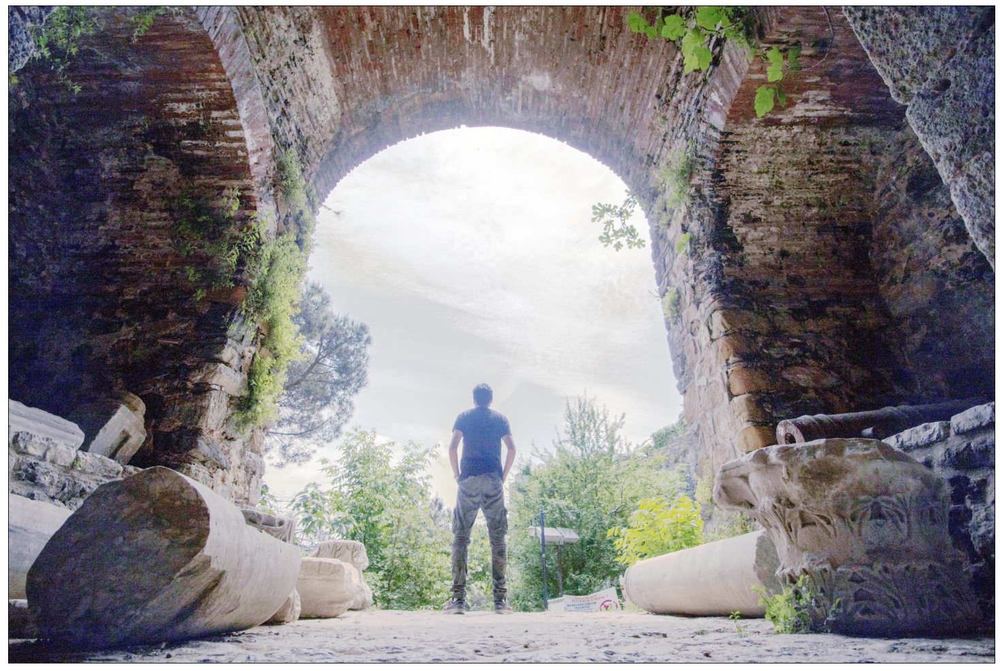

In [40]:
# Изображение после equalizeHist
if use_graph:
    figure(figsize=(32, 16), dpi=80)
    plt.imshow(cv2.cvtColor(image_equalizeHist, cv2.COLOR_BGR2RGB))
    plt.xticks([]),plt.yticks([])
    plt.show()

Результат красивый, чем-то на экспоненциальное преобразование похож, но больше деталей сохраняет. 

In [41]:
# CLAHE
clahe = cv2.createCLAHE(clipLimit=4.0, tileGridSize=(16,16))
channels = cv2.split(image)
for i in range(len(channels)):
    channels[i] = clahe.apply(channels[i])
image_CLAHE = cv2.merge(channels)
hist_CLAHE = calc_hist(image_equalizeHist)

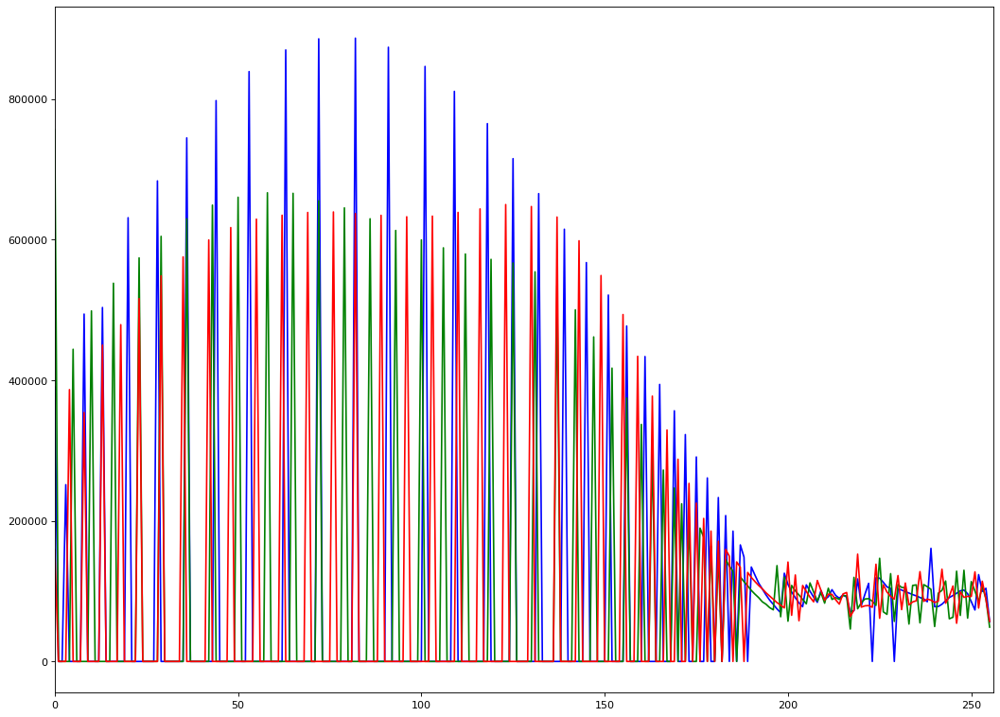

In [42]:
# Отображу полученную после CLAHE гистограмму
if use_graph:
    color = ('b','g','r')
    figure(figsize=(16, 12), dpi=80)
    for i, col in enumerate(color):
        plt.plot(hist_CLAHE[i], color = col)
    plt.xlim([0,256])

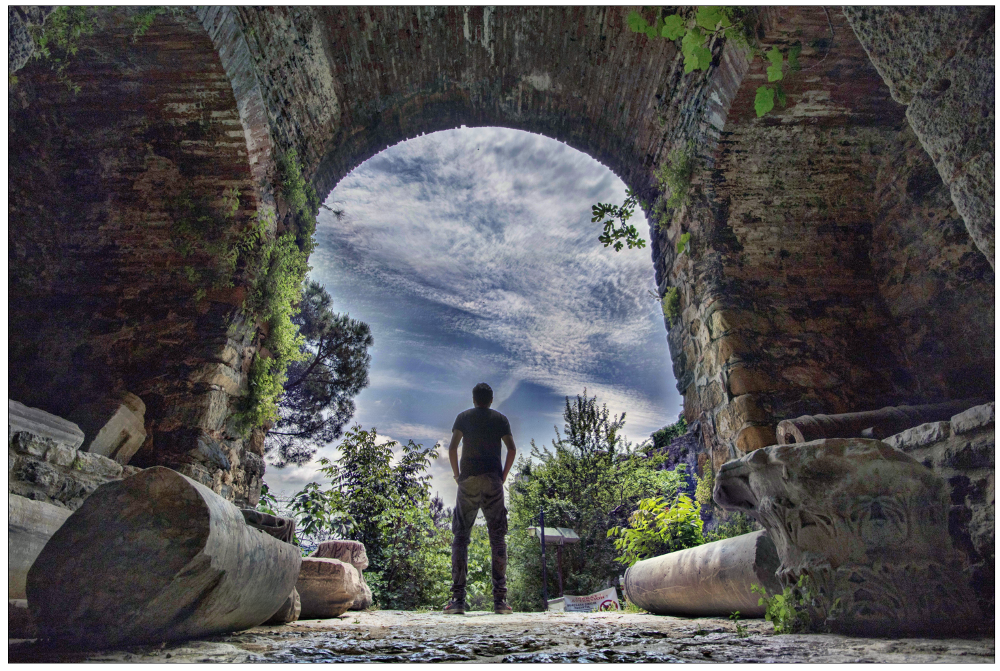

In [43]:
# Изображение после CLAHE
if use_graph:
    figure(figsize=(32, 16), dpi=80)
    plt.imshow(cv2.cvtColor(image_CLAHE, cv2.COLOR_BGR2RGB))
    plt.xticks([]),plt.yticks([])
    plt.show()

#### ВАУ! Мы нашли победителя!

Детали видно просто превосходно, изменяя параметры можно добиться распознавания 
даже самых тёмных участков, не мешая светлым.
Единственный минус, при большом размере матрицы оценки интенсивности места перепада интенсивности 
могут быть не корректно засвечены, но это только добавляет красоты итоговой картинке.